In [1]:
!pip install setuptools


In [2]:
cd C:\Users\willi\actt\src


C:\Users\willi\actt\src


In [3]:
!python setup.py develop


running develop
running egg_info
writing CAN_objects.egg-info\PKG-INFO
writing dependency_links to CAN_objects.egg-info\dependency_links.txt
writing top-level names to CAN_objects.egg-info\top_level.txt
reading manifest file 'CAN_objects.egg-info\SOURCES.txt'
writing manifest file 'CAN_objects.egg-info\SOURCES.txt'
running build_ext
Creating c:\users\willi\miniconda3\envs\ornl_new\lib\site-packages\CAN-objects.egg-link (link to .)
CAN-objects 0.4.0 is already the active version in easy-install.pth

Installed c:\users\willi\actt\src
Processing dependencies for CAN-objects==0.4.0
Finished processing dependencies for CAN-objects==0.4.0


C:\Users\willi\miniconda3\envs\ornl_new\lib\site-packages\setuptools\command\develop.py:40: EasyInstallDeprecationWarning: easy_install command is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` and ``easy_install``.
        Instead, use pypa/build, pypa/installer or other
        standards-based tools.

        See https://github.com/pypa/setuptools/issues/917 for details.
        ********************************************************************************

!!
  easy_install.initialize_options(self)
C:\Users\willi\miniconda3\envs\ornl_new\lib\site-packages\setuptools\_distutils\cmd.py:66: SetuptoolsDeprecationWarning: setup.py install is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` directly.
        Instead, use pypa/build, pypa/installer or other
        standards-based tools.

    

In [4]:
!pip install bitstring
!pip install seaborn
!pip install cantools
import os 
import sys
import numpy as np
from collections import defaultdict
import CAN_objects.aid_message
import matplotlib.pyplot as plt
%matplotlib inline
from generalFunctions import unpickle
import subprocess

import importlib
importlib.reload(CAN_objects.aid_message)

<module 'CAN_objects.aid_message' from 'C:\\Users\\willi\\actt\\src\\CAN_objects\\aid_message.py'>

In [5]:
import os
import sys

sys.path.insert(0, os.path.dirname(os.getcwd()) + "/code/")
!pip install opencv-python
!pip install helper_functions
import helper_functions
!pip install networkx
import networkx

!pip install tqdm
from tqdm import tqdm

import numpy as np
import pandas as pd
from scipy.integrate import quad

import matplotlib.pyplot as plt
%matplotlib inline

import json
import fnmatch
import scipy

!pip install scikit-learn
from sklearn.metrics import auc
from sklearn.covariance import EllipticEnvelope


In [6]:
# path for log file 'C:\Users\willi\OneDrive\Desktop\Research\oak_ridge_in_vehicle\road'
file = 'C:\\Users\\willi\\OneDrive\\Desktop\\Research\\oak_ridge_in_vehicle\\road\\ambient\\ambient_dyno_drive_basic_long.log'


### Calling out make_can_df

In [7]:
def make_can_df(log_filepath):

    can_df = pd.read_fwf(
        log_filepath, delimiter = ' '+ '#' + '('+')',
        skiprows = 1,skipfooter=1,
        usecols = [0,2,3],
        dtype = {0:'float64', 1:str, 2: str},
        names = ['time','pid', 'data'] )

    can_df.pid = can_df.pid.apply(lambda x: int(x,16))
    can_df.data = can_df.data.apply(lambda x: x.zfill(16)) #pad with 0s on the left for data with dlc < 8
    can_df.time = can_df.time - can_df.time.min()
    return can_df[can_df.pid<=0x700]

In [8]:
# Read the log file and parse the contents into a DataFrame
df = make_can_df(file)
df

,time,pid,data
0,0.000000,813,0000042758010000
1,0.001019,1694,0440047E1FC01542
2,0.001020,293,9000401F41BE7960
3,0.002916,737,0000000000000004
4,0.003937,852,1FFF40000003B680
...,...,...,...
2991265,1250.942507,1505,893FE00B0A000080
2991266,1250.942508,1413,0040000000020018
2991267,1250.943525,51,0007A0000E0007D0
2991268,1250.943526,628,00F208F7107C81DD


In [9]:
# Print the first few rows and the column names of the DataFrame
df = make_can_df(file)
print(df.head())
print(df.columns)


       time   pid              data
0  0.000000   813  0000042758010000
1  0.001019  1694  0440047E1FC01542
2  0.001020   293  9000401F41BE7960
3  0.002916   737  0000000000000004
4  0.003937   852  1FFF40000003B680
Index(['time', 'pid', 'data'], dtype='object')


In [10]:
# Sort the DataFrame by the 'time' column and round the 'time' values to 2 decimal places
df_sorted = df.sort_values('time')
df_sorted['time'] = df_sorted['time'].round(2)


In [11]:
# Divide the sorted DataFrame into time slices of duration 10.0 and print each slice along with its label
time_slice_duration = 10.0
num_slices = int(df_sorted['time'].max() / time_slice_duration) + 1
for i in range(num_slices):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_label = f"Time Slice {i + 1}: ({start_time}, {end_time}]"
    time_slice_df = df_sorted[(df_sorted['time'] > start_time) & (df_sorted['time'] <= end_time)]
    print(f"{time_slice_label}\n{time_slice_df}\n")


Time Slice 1: (0.0, 10.0]
        time   pid              data
9       0.01  1255  0000001703520000
10      0.01   339  00000004000C0004
12      0.01   661  0000000000000840
13      0.01  1634  4F20000040000000
14      0.01  1668  54D580194147501E
...      ...   ...               ...
23919  10.00   737  0000000000000004
23920  10.00   852  1FF1C0000005A280
23921  10.00  1505  893FE00B0A016480
23922  10.00   354  00080593EA11F4CE
23923  10.00   167  0010FA69512820A0

[22405 rows x 3 columns]

Time Slice 2: (10.0, 20.0]
        time   pid              data
23924  10.01  1255  0000001703520000
23925  10.01   339  00000000000C000A
23927  10.01  1634  4F20000040000000
23928  10.01  1668  54D580194147501E
23929  10.01  1590  24760000EE8A8000
...      ...   ...               ...
47834  20.00   737  0000000000000004
47835  20.00   852  1FE2400000075680
47836  20.00  1505  893FE00B0A00B480
47837  20.00   354  000802D3EA11F4CE
47838  20.00   167  0010FAE9512820A0

[22405 rows x 3 columns]

Time 

### Building graphs for each time window (edges)

##### Save the Graphs to Disk:

In [21]:
import pickle
import networkx as nx
import pandas as pd
from tqdm import tqdm


# Define the time slice duration in seconds
time_slice_duration = 10.0

# Determine the number of time slices
num_slices = int(df['time'].max() / time_slice_duration) + 1

# Lists to store the graphs
graphs = []

# Using tqdm in the loop for progress tracking
for i in tqdm(range(num_slices), desc="Generating Graphs"):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_df = df[(df['time'] > start_time) & (df['time'] <= end_time)]

    # Build the graph for the current time slice
    G = nx.DiGraph()
    node_ids = time_slice_df['pid'].unique().tolist()
    G.add_nodes_from(node_ids)

    for j in range(len(time_slice_df) - 1):
        source = time_slice_df.iloc[j]['pid']
        target = time_slice_df.iloc[j+1]['pid']

        if G.has_edge(source, target):
            G[source][target]['weight'] += 1
        else:
            G.add_edge(source, target, weight=1)

    # Append the graph to the list
    graphs.append(G)

# Save the graphs to a pickle file
with open("saved_graphs.pkl", "wb") as f:
    pickle.dump(graphs, f)


Generating Graphs: 100%|█████████████████████████████████████████████████████████████| 126/126 [10:07<00:00,  4.82s/it]


#### Load the Graphs from Disk and Plot:

Plotting Graphs:  16%|██████████▏                                                     | 20/126 [00:17<01:38,  1.07it/s]C:\Users\willi\AppData\Local\Temp\ipykernel_26212\1949453549.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(i)
Plotting Graphs: 100%|███████████████████████████████████████████████████████████████| 126/126 [01:44<00:00,  1.20it/s]


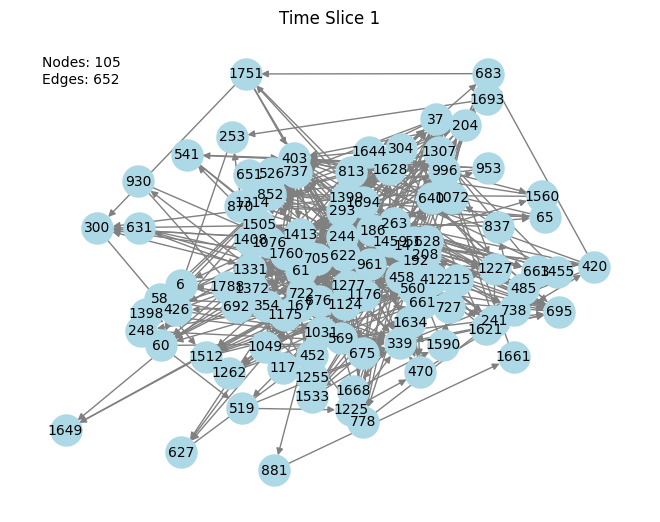

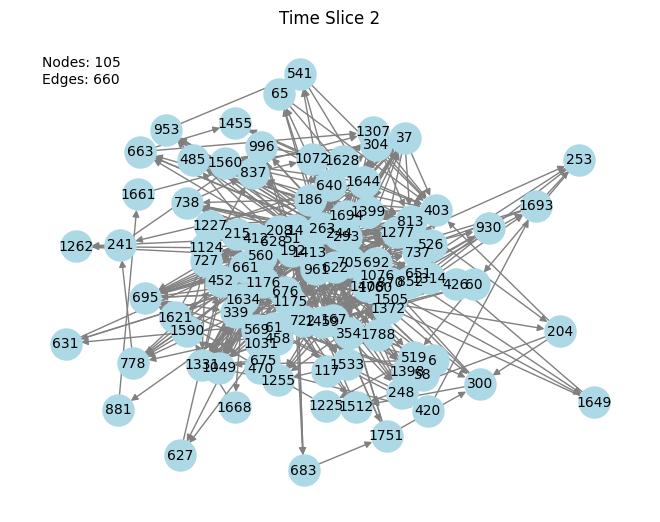

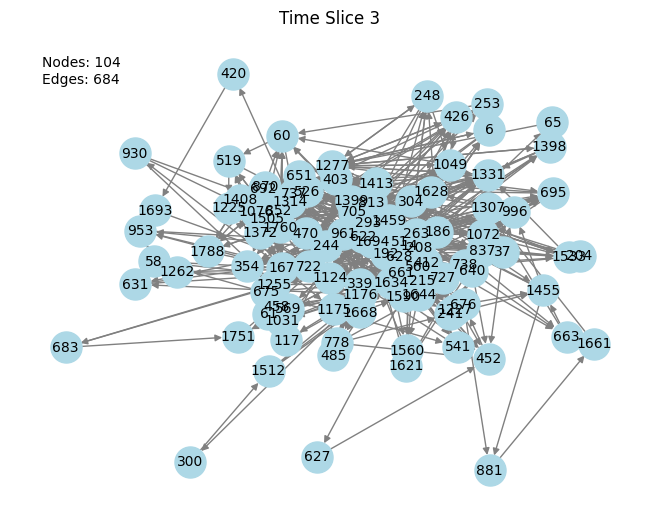

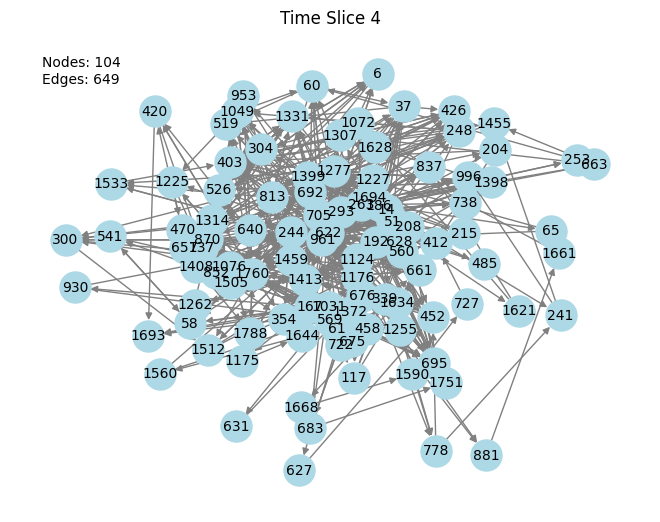

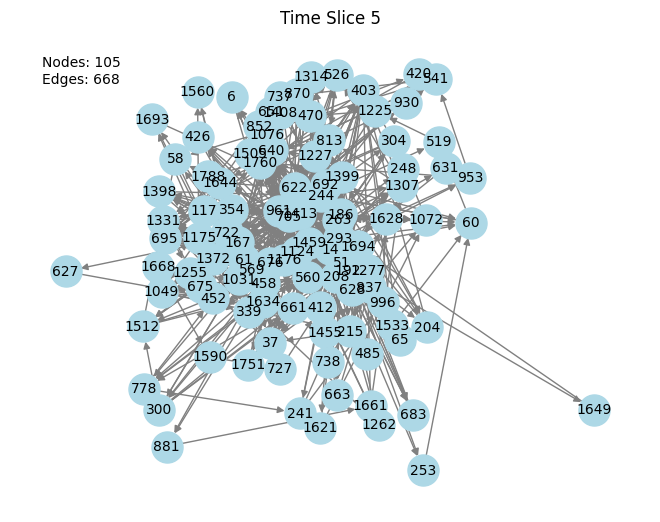

...

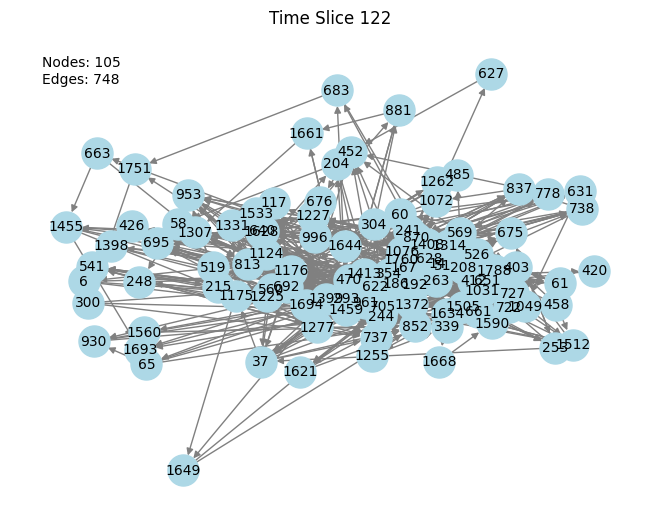

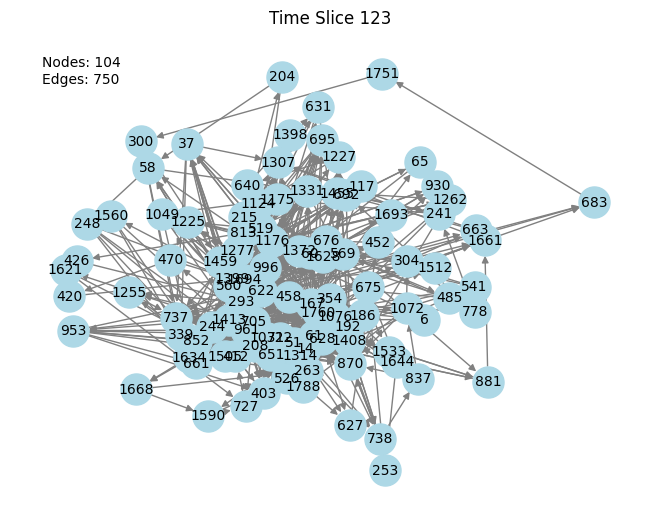

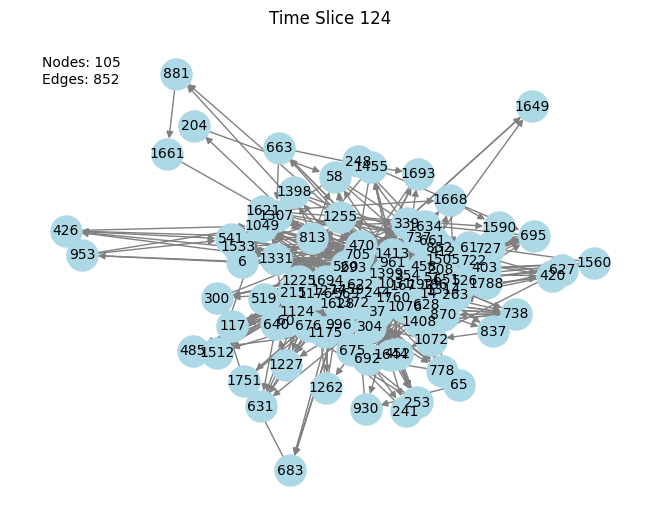

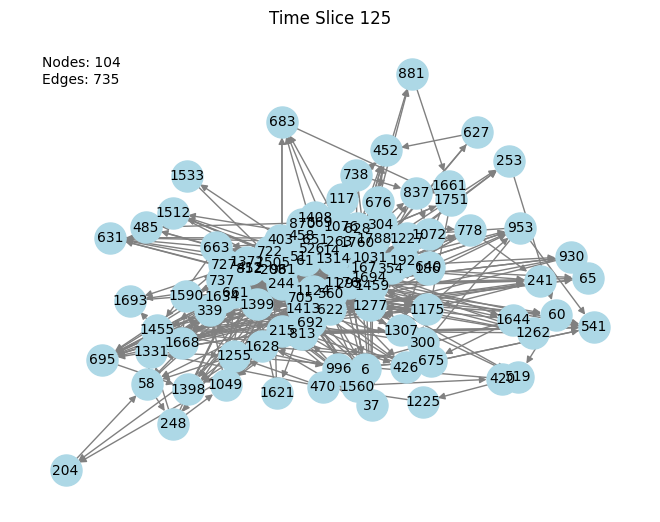

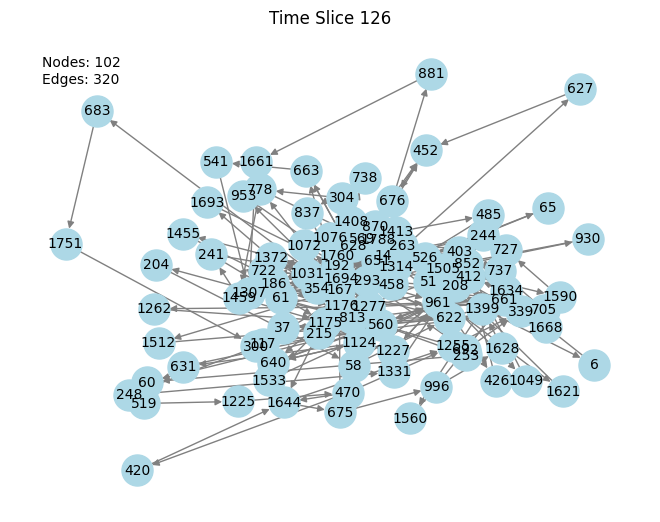

In [12]:
import pickle
import networkx as nx
import matplotlib.pyplot as plt
from tqdm import tqdm

# Load the graphs from the pickle file
with open("saved_graphs.pkl", "rb") as f:
    loaded_graphs = pickle.load(f)

# Using tqdm in the loop for progress tracking
for i, G in tqdm(enumerate(loaded_graphs), total=len(loaded_graphs), desc="Plotting Graphs"):
    time_slice_label = f"Time Slice {i + 1}"
    plt.figure(i)
    nx.draw(G, with_labels=True, node_color='lightblue', node_size=500, font_size=10, edge_color='gray')
    plt.title(time_slice_label)
    plt.text(0.05, 0.95, f'Nodes: {len(G.nodes())}\nEdges: {len(G.edges())}', transform=plt.gca().transAxes, verticalalignment='top')

plt.show()


In [13]:
# Import necessary modules and classes for working with CAN (Controller Area Network) captures
import os
from CAN_objects.capture import MappedCapture, MatchedCapture

In [14]:
# Define the file path for the CAN capture and load the data from the pickle file
cancap_filepath = os.path.join("C:\\Users\\willi\\Dropbox\\data-cancaptures", "road_ambient_dyno_drive_basic_long_050305_002000", "capture.pkl")
cancap = unpickle(cancap_filepath)


In [15]:
# Define the file path for the ground truth DBC file and create a MappedCapture object from the CAN capture data and DBC file
ground_truth_dbc_fpath = os.path.join("C:\\Users\\willi\\Dropbox\\data-cancaptures\\DBC", "anonymized_020822_030640.dbc")
mapped_capture = MappedCapture.init_from_dbc(cancap, ground_truth_dbc_fpath)

### Function to extract the mean and standard deviation for a specific ID in a given time window.

In [16]:
def extract_mean_std_for_id(node_id, start_time, end_time, mapped_capture):
    # Extract the mapped payload for the given ID
    mp = mapped_capture.mapped_payload_dict[node_id]

    # Get the mask for the current time window
    mask = (mp.times >= start_time) & (mp.times < end_time)

    # Create a sub-DataFrame for the current time window
    sub_df = pd.DataFrame()

    for signal in mp.signal_list:
        signal_values = signal.values[mask]
        interpolated_values = pd.Series(signal_values).interpolate(method='linear', limit_area='inside').values
        sub_df[signal.name] = interpolated_values

    # Compute the mean and std for the sub-DataFrame
    mean_std_dict = {}
    for col, (mean, std) in zip(sub_df.columns, zip(sub_df.mean().values, sub_df.std().values)):
        mean_std_dict[f"{col}_mean"] = round(mean, 2)
        mean_std_dict[f"{col}_std"] = round(std, 2)

    return mean_std_dict


### Annotate the nodes with the mean and std attributes

##### Generate and Save Figures

In [20]:
!pip install plotly
import plotly.graph_objects as go
import networkx as nx
import pandas as pd
import math
import pickle
from tqdm import tqdm

# Function to create annotated edges with arrows
def create_annotated_edges(G, pos):
    edge_traces = []
    arrow_annotations = []
    for edge in G.edges():
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        edge_trace = go.Scatter(x=[x0, x1, None], y=[y0, y1, None],
                                line=dict(width=0.1, color='gray'),
                                mode='lines')
        edge_traces.append(edge_trace)

        arrow_annotation = dict(
            ax=x0,
            ay=y0,
            axref='x',
            ayref='y',
            x=x1,
            y=y1,
            xref='x',
            yref='y',
            showarrow=True,
            arrowhead=4,
            arrowsize=1,
            arrowwidth=1,
            arrowcolor='gray'
        )
        arrow_annotations.append(arrow_annotation)

    return edge_traces, arrow_annotations

# Define time slice duration
time_slice_duration = 10.0
num_slices = int(df['time'].max() / time_slice_duration) + 1

# Create an empty list to store figures
all_figures = []

# Loop through time slices and create directed graphs
for i in tqdm(range(num_slices), desc="Generating Figures"):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_label = f"Time Slice {i + 1}: ({start_time}, {end_time}]"
    time_slice_df = df[(df['time'] > start_time) & (df['time'] <= end_time)]
    G = nx.DiGraph()
    node_ids = time_slice_df['pid'].unique().tolist()
    G.add_nodes_from(node_ids)

    for node_id in node_ids:
        mean_std_dict = extract_mean_std_for_id(node_id, start_time, end_time, mapped_capture)
        nx.set_node_attributes(G, {node_id: mean_std_dict})

    for j in range(len(time_slice_df) - 1):
        source = time_slice_df.iloc[j]['pid']
        target = time_slice_df.iloc[j + 1]['pid']
        if G.has_edge(source, target):
            G[source][target]['weight'] += 1
        else:
            G.add_edge(source, target, weight=1)

    pos = nx.spring_layout(G, k=0.15)
    edge_traces, arrow_annotations = create_annotated_edges(G, pos)

    node_x = [pos[node][0] for node in G.nodes()]
    node_y = [pos[node][1] for node in G.nodes()]
    node_text = [f"Node ID: {node}<br>" + "<br>".join([f"{k}: {v}" for k, v in attrs.items()]) for node, attrs in G.nodes(data=True)]

    node_trace = go.Scatter(
        x=node_x, y=node_y,
        mode='markers+text',
        text=[str(node) for node in G.nodes()],
        textposition='middle center',
        textfont=dict(size=10, color='black'),
        hoverinfo='text',
        hovertext=node_text,
        marker=dict(
            showscale=True,
            colorscale='YlGnBu',
            size=30,
            colorbar=dict(
                thickness=15,
                title='Node Connections',
                xanchor='left',
                titleside='right'
            ),
            line_width=2
        )
    )

    fig = go.Figure(data=[*edge_traces, node_trace],
                    layout=go.Layout(
                        showlegend=False,
                        hovermode='closest',
                        margin=dict(b=0, l=0, r=0, t=40),
                        title=dict(
                            text=time_slice_label,
                            x=0.5,
                            xanchor='center',
                            font=dict(
                                size=14,
                                color='black'
                            )
                        ),
                        xaxis=dict(showgrid=False, zeroline=False),
                        yaxis=dict(showgrid=False, zeroline=False),
                        annotations=arrow_annotations
                    )
    )
    
    # Store the figures
    all_figures.append(fig)

# Save the figures to disk
with open("saved_figures.pkl", "wb") as f:
    pickle.dump(all_figures, f)


Generating Figures: 100%|████████████████████████████████████████████████████████████| 126/126 [05:01<00:00,  2.39s/it]


##### Loading Graphs from the Pickle File 

In [17]:
os.getcwd()

'C:\\Users\\willi\\actt\\src'

In [18]:
import pickle
from tqdm.notebook import tqdm

# Load the saved figures from disk
with open("saved_figures.pkl", "rb") as f:
    loaded_figures = pickle.load(f)

# Display the first 10 graphs
for fig in tqdm(loaded_figures[:10], desc="Displaying Figures"):
    fig.show()

# To display a specific graph later, we can do:
# loaded_figures[index].show()
# For example, to show the first graph, use:
# loaded_figures[0].show()


Displaying Figures:   0%|          | 0/10 [00:00<?, ?it/s]

### display the graph for (time slice 126):

In [43]:
all_figures[125].show()


### Load the saved graphs from the disk:

In [22]:
print("Loading graphs from disk...")
with open("saved_graphs.pkl", "rb") as f:
    all_graphs_original = pickle.load(f)  # Keeping original indexing


Loading graphs from disk...


### Node2vec implementation

In [23]:
import multiprocessing
num_cores = multiprocessing.cpu_count()
print(num_cores)


20


In [24]:
from node2vec import Node2Vec
from tqdm import tqdm
import numpy as np

# Initialize a list to hold embeddings for all nodes across all graphs
all_node_embeddings = []

# Iterate over all graphs
for G in tqdm(all_graphs_original, desc="Generating Node Embeddings"):
    # Embed the graph using node2vec; p and q values can be adjusted as needed
    # since our graph is weighted, Node2Vec automatically considers the weights
    node2vec = Node2Vec(G, dimensions=64, walk_length=30, num_walks=200, workers=18, p=1.5, q=0.5)
    model = node2vec.fit(window=10, min_count=1, batch_words=4)
    
    node_embeddings = {}
    for node in G.nodes():
        # Check if node was embedded
        if node in model.wv:
            node_emb = model.wv[node]
            node_embeddings[node] = node_emb
        else:
            # Assign zero vector for nodes that didn't get an embedding
            node_embeddings[node] = np.zeros(model.vector_size)
    
    all_node_embeddings.append(node_embeddings)


Generating Node Embeddings:   0%|                                                              | 0/126 [00:00<?, ?it/s]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:   1%|▍                                                     | 1/126 [00:17<36:46, 17.65s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:   2%|▊                                                     | 2/126 [00:30<30:42, 14.86s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:   2%|█▎                                                    | 3/126 [00:43<28:44, 14.02s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:   3%|█▋                                                    | 4/126 [00:55<27:02, 13.30s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:   4%|██▏                                                   | 5/126 [01:07<26:00, 12.89s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:   5%|██▌                                                   | 6/126 [01:22<26:37, 13.31s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:   6%|███                                                   | 7/126 [01:34<25:30, 12.86s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:   6%|███▍                                                  | 8/126 [01:46<25:14, 12.83s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:   7%|███▊                                                  | 9/126 [01:58<24:10, 12.40s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:   8%|████▏                                                | 10/126 [02:09<23:32, 12.18s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:   9%|████▋                                                | 11/126 [02:21<23:10, 12.09s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  10%|█████                                                | 12/126 [02:34<23:26, 12.34s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  10%|█████▍                                               | 13/126 [02:49<24:44, 13.13s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  11%|█████▉                                               | 14/126 [03:02<24:16, 13.00s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  12%|██████▎                                              | 15/126 [03:15<23:56, 12.94s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  13%|██████▋                                              | 16/126 [03:27<23:21, 12.74s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  13%|███████▏                                             | 17/126 [03:40<23:09, 12.75s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  14%|███████▌                                             | 18/126 [03:54<23:31, 13.07s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  15%|███████▉                                             | 19/126 [04:09<24:21, 13.66s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  16%|████████▍                                            | 20/126 [04:20<22:57, 13.00s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  17%|████████▊                                            | 21/126 [04:32<22:10, 12.67s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  17%|█████████▎                                           | 22/126 [04:45<21:59, 12.68s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  18%|█████████▋                                           | 23/126 [04:57<21:29, 12.52s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  19%|██████████                                           | 24/126 [05:08<20:38, 12.15s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  20%|██████████▌                                          | 25/126 [05:21<20:49, 12.37s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  21%|██████████▉                                          | 26/126 [05:38<22:56, 13.77s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  21%|███████████▎                                         | 27/126 [05:52<22:41, 13.76s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  22%|███████████▊                                         | 28/126 [06:04<21:40, 13.27s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  23%|████████████▏                                        | 29/126 [06:18<21:41, 13.42s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  24%|████████████▌                                        | 30/126 [06:29<20:38, 12.91s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  25%|█████████████                                        | 31/126 [06:42<20:06, 12.70s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  25%|█████████████▍                                       | 32/126 [06:54<19:48, 12.64s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  26%|█████████████▉                                       | 33/126 [07:06<19:05, 12.31s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  27%|██████████████▎                                      | 34/126 [07:17<18:34, 12.11s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  28%|██████████████▋                                      | 35/126 [07:29<18:11, 11.99s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  29%|███████████████▏                                     | 36/126 [07:41<18:06, 12.08s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  29%|███████████████▌                                     | 37/126 [07:53<17:44, 11.96s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  30%|███████████████▉                                     | 38/126 [08:05<17:33, 11.97s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  31%|████████████████▍                                    | 39/126 [08:17<17:23, 11.99s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  32%|████████████████▊                                    | 40/126 [08:28<16:58, 11.85s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  33%|█████████████████▏                                   | 41/126 [08:42<17:32, 12.38s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  33%|█████████████████▋                                   | 42/126 [08:57<18:31, 13.23s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  34%|██████████████████                                   | 43/126 [09:09<17:41, 12.79s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  35%|██████████████████▌                                  | 44/126 [09:22<17:22, 12.71s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  36%|██████████████████▉                                  | 45/126 [09:34<17:04, 12.65s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  37%|███████████████████▎                                 | 46/126 [09:46<16:29, 12.37s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  37%|███████████████████▊                                 | 47/126 [09:58<16:09, 12.27s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  38%|████████████████████▏                                | 48/126 [10:10<15:53, 12.23s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  39%|████████████████████▌                                | 49/126 [10:23<15:50, 12.34s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  40%|█████████████████████                                | 50/126 [10:35<15:46, 12.46s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  40%|█████████████████████▍                               | 51/126 [10:48<15:36, 12.48s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  41%|█████████████████████▊                               | 52/126 [11:03<16:21, 13.26s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  42%|██████████████████████▎                              | 53/126 [11:15<15:50, 13.01s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  43%|██████████████████████▋                              | 54/126 [11:30<16:01, 13.35s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  44%|███████████████████████▏                             | 55/126 [11:43<15:53, 13.43s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  44%|███████████████████████▌                             | 56/126 [11:58<16:15, 13.94s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  45%|███████████████████████▉                             | 57/126 [12:11<15:35, 13.55s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  46%|████████████████████████▍                            | 58/126 [12:25<15:42, 13.86s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  47%|████████████████████████▊                            | 59/126 [12:39<15:24, 13.80s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  48%|█████████████████████████▏                           | 60/126 [12:52<14:55, 13.57s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  48%|█████████████████████████▋                           | 61/126 [13:05<14:23, 13.28s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  49%|██████████████████████████                           | 62/126 [13:17<13:48, 12.94s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  50%|██████████████████████████▌                          | 63/126 [13:32<14:09, 13.49s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  51%|██████████████████████████▉                          | 64/126 [13:45<13:54, 13.45s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  52%|███████████████████████████▎                         | 65/126 [13:58<13:29, 13.27s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  52%|███████████████████████████▊                         | 66/126 [14:12<13:24, 13.41s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  53%|████████████████████████████▏                        | 67/126 [14:26<13:26, 13.67s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  54%|████████████████████████████▌                        | 68/126 [14:39<13:04, 13.52s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  55%|█████████████████████████████                        | 69/126 [14:55<13:23, 14.09s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  56%|█████████████████████████████▍                       | 70/126 [15:09<13:16, 14.22s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  56%|█████████████████████████████▊                       | 71/126 [15:25<13:26, 14.66s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  57%|██████████████████████████████▎                      | 72/126 [15:40<13:15, 14.73s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  58%|██████████████████████████████▋                      | 73/126 [15:52<12:28, 14.12s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  59%|███████████████████████████████▏                     | 74/126 [16:06<12:08, 14.01s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  60%|███████████████████████████████▌                     | 75/126 [16:18<11:29, 13.53s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  60%|███████████████████████████████▉                     | 76/126 [16:31<10:55, 13.11s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  61%|████████████████████████████████▍                    | 77/126 [16:44<10:44, 13.15s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  62%|████████████████████████████████▊                    | 78/126 [16:56<10:09, 12.71s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  63%|█████████████████████████████████▏                   | 79/126 [17:09<10:12, 13.04s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  63%|█████████████████████████████████▋                   | 80/126 [17:22<09:48, 12.79s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  64%|██████████████████████████████████                   | 81/126 [17:36<09:55, 13.22s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  65%|██████████████████████████████████▍                  | 82/126 [17:50<09:59, 13.64s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  66%|██████████████████████████████████▉                  | 83/126 [18:05<09:57, 13.89s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  67%|███████████████████████████████████▎                 | 84/126 [18:19<09:43, 13.90s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  67%|███████████████████████████████████▊                 | 85/126 [18:33<09:39, 14.15s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  68%|████████████████████████████████████▏                | 86/126 [18:46<09:07, 13.70s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  69%|████████████████████████████████████▌                | 87/126 [19:01<09:10, 14.11s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  70%|█████████████████████████████████████                | 88/126 [19:14<08:38, 13.65s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  71%|█████████████████████████████████████▍               | 89/126 [19:26<08:04, 13.10s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  71%|█████████████████████████████████████▊               | 90/126 [19:38<07:46, 12.97s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  72%|██████████████████████████████████████▎              | 91/126 [19:51<07:29, 12.84s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  73%|██████████████████████████████████████▋              | 92/126 [20:05<07:30, 13.25s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  74%|███████████████████████████████████████              | 93/126 [20:17<07:06, 12.93s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  75%|███████████████████████████████████████▌             | 94/126 [20:34<07:32, 14.15s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  75%|███████████████████████████████████████▉             | 95/126 [20:46<07:00, 13.56s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  76%|████████████████████████████████████████▍            | 96/126 [21:03<07:11, 14.39s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  77%|████████████████████████████████████████▊            | 97/126 [21:20<07:19, 15.16s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  78%|█████████████████████████████████████████▏           | 98/126 [21:35<07:04, 15.16s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  79%|█████████████████████████████████████████▋           | 99/126 [21:49<06:42, 14.91s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  79%|█████████████████████████████████████████▎          | 100/126 [22:03<06:17, 14.50s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  80%|█████████████████████████████████████████▋          | 101/126 [22:15<05:45, 13.82s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  81%|██████████████████████████████████████████          | 102/126 [22:29<05:31, 13.83s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  82%|██████████████████████████████████████████▌         | 103/126 [22:42<05:16, 13.74s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  83%|██████████████████████████████████████████▉         | 104/126 [22:56<05:03, 13.81s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  83%|███████████████████████████████████████████▎        | 105/126 [23:09<04:42, 13.44s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  84%|███████████████████████████████████████████▋        | 106/126 [23:21<04:20, 13.02s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  85%|████████████████████████████████████████████▏       | 107/126 [23:33<04:01, 12.69s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  86%|████████████████████████████████████████████▌       | 108/126 [23:44<03:40, 12.27s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  87%|████████████████████████████████████████████▉       | 109/126 [23:56<03:28, 12.25s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  87%|█████████████████████████████████████████████▍      | 110/126 [24:08<03:14, 12.16s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  88%|█████████████████████████████████████████████▊      | 111/126 [24:21<03:02, 12.18s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  89%|██████████████████████████████████████████████▏     | 112/126 [24:32<02:48, 12.06s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  90%|██████████████████████████████████████████████▋     | 113/126 [24:45<02:37, 12.11s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  90%|███████████████████████████████████████████████     | 114/126 [24:57<02:26, 12.17s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  91%|███████████████████████████████████████████████▍    | 115/126 [25:08<02:10, 11.85s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  92%|███████████████████████████████████████████████▊    | 116/126 [25:19<01:57, 11.71s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  93%|████████████████████████████████████████████████▎   | 117/126 [25:31<01:45, 11.74s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  94%|████████████████████████████████████████████████▋   | 118/126 [25:43<01:33, 11.66s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  94%|█████████████████████████████████████████████████   | 119/126 [25:54<01:20, 11.47s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  95%|█████████████████████████████████████████████████▌  | 120/126 [26:05<01:08, 11.38s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  96%|█████████████████████████████████████████████████▉  | 121/126 [26:17<00:57, 11.51s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  97%|██████████████████████████████████████████████████▎ | 122/126 [26:28<00:46, 11.62s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  98%|██████████████████████████████████████████████████▊ | 123/126 [26:41<00:36, 12.04s/it]

Computing transition probabilities:   0%|          | 0/105 [00:00<?, ?it/s]

Generating Node Embeddings:  98%|███████████████████████████████████████████████████▏| 124/126 [26:53<00:24, 12.01s/it]

Computing transition probabilities:   0%|          | 0/104 [00:00<?, ?it/s]

Generating Node Embeddings:  99%|███████████████████████████████████████████████████▌| 125/126 [27:06<00:12, 12.05s/it]

Computing transition probabilities:   0%|          | 0/102 [00:00<?, ?it/s]

Generating Node Embeddings: 100%|████████████████████████████████████████████████████| 126/126 [27:17<00:00, 13.00s/it]


### Combining Node Embeddings with Node Attributes

In [25]:
all_combined_node_embeddings = []

# Calculate the maximum number of attributes across all nodes and all graphs
max_attributes = max([len(extract_mean_std_for_id(node, start_time, end_time, mapped_capture))
                      for graph in all_graphs_original
                      for node in graph.nodes()])

# Iterate over all graphs and their index
for idx, G in tqdm(enumerate(all_graphs_original), desc="Combining Node Embeddings with Attributes"):
    current_embeddings = all_node_embeddings[idx]
    
    # Calculate start_time and end_time based on the current graph index (idx)
    start_time = idx * time_slice_duration
    end_time = (idx + 1) * time_slice_duration
    
    combined_embeddings = {}
    for node in G.nodes():
        # Get node2vec embedding for the node
        node_emb = current_embeddings[node]
        
        # Extract mean and std attributes using the mean and std function
        mean_std_dict = extract_mean_std_for_id(node, start_time, end_time, mapped_capture)
        
        # Ensure the node attribute vector is of consistent length
        attributes = list(mean_std_dict.values())
        attributes += [0] * (max_attributes - len(attributes))
        
        # Combine node embeddings and attributes
        combined_embedding = np.concatenate([node_emb, np.array(attributes)])
        
        combined_embeddings[node] = combined_embedding

    all_combined_node_embeddings.append(combined_embeddings)


Combining Node Embeddings with Attributes: 126it [00:32,  3.86it/s]


In [26]:
# Display the first few combined embeddings for the first graph
print(all_combined_node_embeddings[0])


{1694: array([0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
       0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
       0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
       0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
       0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
       0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
       0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
       0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
       0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
       0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
       0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
       0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
       0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.0000e+00,
       0.0000e+00, 1.2215e+02, 4.5000e+00, 1.2731e+02, 4.6000e-01,
       1.0000e-02, 8.0000e-02, 1.6948e+02, 5.3000e-01, 

In [27]:
all_combined_node_embeddings[0][1694].shape


(108,)

### Finding node with the highest number of signals

In [49]:
# Initialize variables to keep track of the node with the highest number of signals
highest_signal_count = 0
node_with_highest_signals = None

# Iterate through the node IDs
for node_id in mapped_capture.mapped_payload_dict.keys():
    # Get the mapped payload for the current node
    mp = mapped_capture.mapped_payload_dict[node_id]
    
    # Count the number of signals for this node
    signal_count = len(mp.signal_list)
    
    # Check if this node has more signals than the current highest count
    if signal_count > highest_signal_count:
        highest_signal_count = signal_count
        node_with_highest_signals = node_id

# Print the node with the highest number of signals and the signal count
print(f"Node with Highest Signals (Node ID, Signal Count): ({node_with_highest_signals}, {highest_signal_count})")


Node with Highest Signals (Node ID, Signal Count): (663, 22)


In [56]:
import numpy as np

# Assuming you have 'all_combined_node_embeddings' as a list of dictionaries
# and 'highest_signal_count' as the highest number of signals.

# Calculate the new dimension based on 64 + (2 attributes * highest number of signals)
new_dimension = 64 + (2 * highest_signal_count)

# Initialize a dictionary to store concatenated embeddings
concatenated_embeddings = {}

# Iterate through all graphs in the capture
for graph_embeddings in all_combined_node_embeddings:
    # Initialize variables to accumulate embeddings and count nodes
    total_embeddings = np.zeros((new_dimension,))
    num_nodes = 0

    # Iterate through node embeddings in the current graph
    for node_id, node_embedding in graph_embeddings.items():
        # Pad node embeddings to the new dimension
        padded_embeddings = np.pad(node_embedding, (0, new_dimension - len(node_embedding)), mode='constant')
        
        # Accumulate the padded embeddings
        total_embeddings += padded_embeddings
        num_nodes += 1

    # Calculate average embeddings for the current graph
    if num_nodes > 0:
        average_embeddings = total_embeddings / num_nodes
    else:
        # Handle the case where there are no nodes in the graph
        average_embeddings = np.zeros((new_dimension,))
    
    # Store the average embeddings in the dictionary
    concatenated_embeddings[len(concatenated_embeddings)] = average_embeddings

# Print the number of graphs processed and the keys in concatenated_embeddings
print("Number of graphs processed:", len(concatenated_embeddings))
print("Keys in concatenated_embeddings:", list(concatenated_embeddings.keys()))


Number of graphs processed: 126
Keys in concatenated_embeddings: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125]


### To access the embeddings for the first graph 

In [73]:
concatenated_embeddings[0]

array([-8.79988376e-04, -3.79369610e-03,  2.08810510e-03,  5.34444148e-03,
       -1.86069064e-03, -9.90559416e-03,  3.93944449e-03, -4.48517516e-03,
       -7.55786830e-03, -3.24390840e-03,  1.62404286e-02, -1.21649736e-02,
       -4.84892506e-03, -5.11848840e-03,  4.33232603e-03, -1.02756413e-03,
        6.13981326e-03, -8.17100058e-03, -1.22464220e-02,  2.02958062e-02,
        1.53907647e-02,  1.42405704e-02, -8.66309357e-03, -2.15509433e-02,
        5.31488591e-03, -4.63960893e-03, -2.31174265e-02,  1.72243014e-03,
        4.61869702e-03, -3.25723922e-03, -1.11409776e-02, -3.05099562e-03,
       -1.60165379e-03, -3.53976288e-03, -1.18511788e-02, -1.23784865e-02,
        1.44228331e-03, -4.76774305e-03,  1.18452530e-02, -7.14589584e-04,
       -3.84957652e-03,  1.97025640e-03,  5.19092910e-03, -1.46758666e-02,
       -2.83519387e-03,  5.20563212e-03,  2.66619626e-03, -4.59520909e-03,
        6.65656885e-03,  1.05438279e-02,  4.28722448e-03,  9.74333618e-03,
       -8.42345080e-04,  

### To verify that all the averaged concatenated embeddings have the same dimension

In [58]:
# Initialize a variable to store the expected dimension
expected_dimension = None

# Iterate through all graphs in concatenated_embeddings
for graph_id, concatenated_embedding in concatenated_embeddings.items():
    # Get the dimension of the current concatenated embedding
    embedding_dimension = concatenated_embedding.shape[0]
    
    # If it's the first graph, set the expected dimension
    if expected_dimension is None:
        expected_dimension = embedding_dimension
    
    # Compare the dimension of the current graph with the expected dimension
    if embedding_dimension != expected_dimension:
        print(f"Graph {graph_id} has a different dimension ({embedding_dimension}), expected: {expected_dimension}")

# If all dimensions matched, print a message
if expected_dimension is not None:
    print("All concatenated embeddings have the same dimension:", expected_dimension)


All concatenated embeddings have the same dimension: 108


### To verify individually

In [72]:
# Choose a graph ID to check
graph_id = 121

# Get the concatenated embedding for the chosen graph
chosen_embedding = concatenated_embeddings[graph_id]

# Check its dimension
embedding_dimension = chosen_embedding.shape[0]
print(f"Dimension of concatenated embedding for graph {graph_id}: {embedding_dimension}")


Dimension of concatenated embedding for graph 121: 108


In [67]:
import pandas as pd

# Create a list to store the embeddings and labels
data = []

# Iterate through the benign embeddings
for graph_id, embedding in concatenated_embeddings.items():
    # Append the embedding and label to the data list
    data.append((embedding, '0'))

# Create a DataFrame
df_benign = pd.DataFrame(data, columns=['Embedding', 'Label'])

# Display the first few rows of the DataFrame
print(df_benign.head())


                                           Embedding   Label
0  [-0.0008799883758737928, -0.003793696101222719...  benign
1  [0.004300778465611594, -0.0045570757306580036,...  benign
2  [-0.0026028487258232557, -0.006606852922302026...  benign
3  [-0.00609728443221404, -0.0024239713182816138,...  benign
4  [0.0060762166267349605, -0.012679322542334419,...  benign


In [77]:
##To ensure that the graph embeddings consider the weights, directions

for u, v, data in G.edges(data=True):
    print(u, v, data)
##

1255 339 {'weight': 10}
339 1634 {'weight': 32}
339 661 {'weight': 16}
1634 1668 {'weight': 5}
1634 412 {'weight': 38}
1634 737 {'weight': 5}
1668 737 {'weight': 5}
1668 1590 {'weight': 5}
737 852 {'weight': 46}
737 961 {'weight': 2}
852 1505 {'weight': 89}
852 403 {'weight': 4}
852 244 {'weight': 2}
1505 1590 {'weight': 5}
1505 651 {'weight': 11}
1505 628 {'weight': 20}
1505 51 {'weight': 14}
1505 403 {'weight': 34}
1505 1668 {'weight': 5}
1505 208 {'weight': 3}
1505 14 {'weight': 1}
1505 244 {'weight': 1}
1505 1413 {'weight': 1}
1590 727 {'weight': 10}
727 412 {'weight': 5}
727 263 {'weight': 5}
412 263 {'weight': 5}
412 208 {'weight': 40}
412 961 {'weight': 3}
263 14 {'weight': 45}
263 1760 {'weight': 1}
263 354 {'weight': 1}
14 208 {'weight': 4}
14 1408 {'weight': 10}
14 1760 {'weight': 13}
14 870 {'weight': 27}
14 1413 {'weight': 4}
14 192 {'weight': 13}
14 1076 {'weight': 2}
14 412 {'weight': 5}
14 186 {'weight': 3}
14 354 {'weight': 2}
14 651 {'weight': 4}
14 1621 {'weight': 1}


 1255: This is the source node of the edge.
    339: This is the target node of the edge.
    {'weight': 10}: This is a dictionary containing edge attributes. In this case, the only attribute shown is weight, which represents the weight of the edge from node 1255 to node 339. The weight here is 10.

So, this line essentially means there's a directed edge from node 1255 to node 339 with a weight of 10.

 ### A single embedding for the 1st graph by taking the average of the concatenated node embeddings:

In [60]:
import numpy as np

# Initialize an empty list to store concatenated embeddings
concatenated_embeddings = []

# Select a graph index to process
graph_idx = 0

# Iterate through all nodes in the selected graph
for node in all_combined_node_embeddings[graph_idx]:
    # Get the concatenated embedding for the current node
    concatenated_embedding = all_combined_node_embeddings[graph_idx][node]
    
    # Append the concatenated embedding to the list
    concatenated_embeddings.append(concatenated_embedding)

# Calculate the average of the concatenated embeddings
average_embedding = np.mean(concatenated_embeddings, axis=0)

# Now, 'average_embedding' contains a single vector representing the entire graph.
# You can use this vector for further analysis or machine learning tasks.


In [61]:
average_embedding

array([ 7.57247440e-03, -4.85672828e-03,  8.93775741e-03, -1.91806386e-03,
       -4.18060614e-03, -1.09329954e-02,  8.43423718e-03,  3.76302323e-04,
       -1.36400070e-02,  1.21842050e-03,  2.55708035e-02, -1.00137467e-02,
       -1.27259349e-04, -6.62515606e-03, -7.44404360e-06,  2.69748029e-03,
       -2.69893876e-04,  5.15626491e-04, -4.27803583e-03,  5.76110041e-03,
       -1.47829796e-03,  1.53173537e-02,  2.38862970e-03, -6.29232058e-03,
       -3.72954603e-03,  3.46270977e-03, -1.90172429e-02, -3.80219136e-03,
       -8.43751739e-03,  8.05989813e-03,  1.05964170e-02,  3.25065489e-03,
        3.71099040e-03, -2.71236600e-03,  3.45051903e-03, -5.87601264e-03,
       -6.55452088e-03,  5.99396005e-03,  1.46088841e-02,  1.23922887e-02,
       -6.69130467e-03,  3.66553034e-03, -6.55214845e-03, -1.12409400e-02,
       -3.49289458e-03, -7.75101848e-03,  3.27224769e-03, -1.88481799e-03,
        1.09562874e-03,  1.97981274e-02,  9.82435150e-03,  5.14764337e-03,
        5.10517220e-03,  

#### Repeating the process for every graph in the database

In [70]:
import numpy as np

# Initialize an empty list to store average embeddings for all graphs
all_average_embeddings = []

# Iterate through all graphs
for graph_idx in range(len(all_combined_node_embeddings)):
    # Initialize an empty list to store concatenated embeddings
    concatenated_embeddings = []

    # Iterate through all nodes in the selected graph
    for node in all_combined_node_embeddings[graph_idx]:
        # Get the concatenated embedding for the current node
        concatenated_embedding = all_combined_node_embeddings[graph_idx][node]
        
        # Replace NaN values with zeros
        concatenated_embedding = np.nan_to_num(concatenated_embedding, nan=0.0)

        # Append the concatenated embedding to the list
        concatenated_embeddings.append(concatenated_embedding)

    # Calculate the average of the concatenated embeddings for the current graph
    average_embedding = np.mean(concatenated_embeddings, axis=0)

    # Append the average embedding to the list of average embeddings for all graphs
    all_average_embeddings.append(average_embedding)

# Now, 'all_average_embeddings' contains a list of average embeddings, one for each graph.


In [71]:
all_average_embeddings

[array([ 7.57247440e-03, -4.85672828e-03,  8.93775741e-03, -1.91806386e-03,
        -4.18060614e-03, -1.09329954e-02,  8.43423718e-03,  3.76302323e-04,
        -1.36400070e-02,  1.21842050e-03,  2.55708035e-02, -1.00137467e-02,
        -1.27259349e-04, -6.62515606e-03, -7.44404360e-06,  2.69748029e-03,
        -2.69893876e-04,  5.15626491e-04, -4.27803583e-03,  5.76110041e-03,
        -1.47829796e-03,  1.53173537e-02,  2.38862970e-03, -6.29232058e-03,
        -3.72954603e-03,  3.46270977e-03, -1.90172429e-02, -3.80219136e-03,
        -8.43751739e-03,  8.05989813e-03,  1.05964170e-02,  3.25065489e-03,
         3.71099040e-03, -2.71236600e-03,  3.45051903e-03, -5.87601264e-03,
        -6.55452088e-03,  5.99396005e-03,  1.46088841e-02,  1.23922887e-02,
        -6.69130467e-03,  3.66553034e-03, -6.55214845e-03, -1.12409400e-02,
        -3.49289458e-03, -7.75101848e-03,  3.27224769e-03, -1.88481799e-03,
         1.09562874e-03,  1.97981274e-02,  9.82435150e-03,  5.14764337e-03,
         5.1

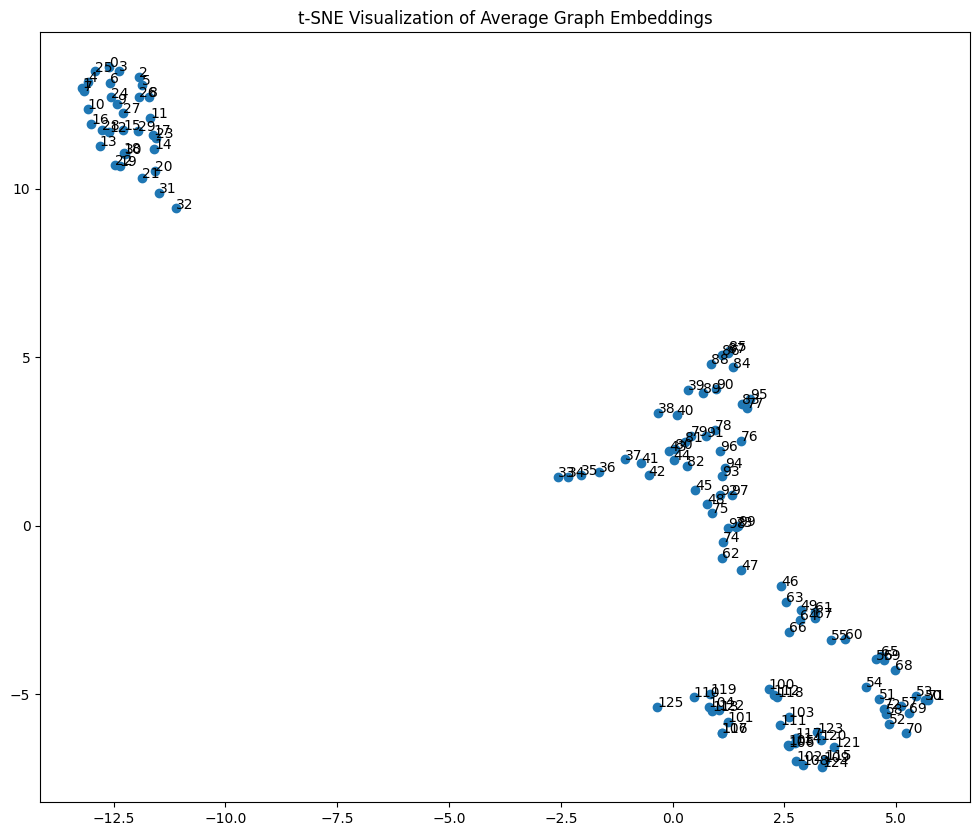

In [74]:
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# Combine all average embeddings into a single numpy array
average_embeddings_array = np.array(all_average_embeddings)

# Apply t-SNE on the embeddings
tsne = TSNE(n_components=2, random_state=42)
transformed_embeddings = tsne.fit_transform(average_embeddings_array)

# Plot the t-SNE representation
plt.figure(figsize=(12, 10))
plt.scatter(transformed_embeddings[:, 0], transformed_embeddings[:, 1])

# Annotate the points with graph indices
for graph_idx in range(len(all_average_embeddings)):
    plt.annotate(str(graph_idx), (transformed_embeddings[graph_idx, 0], transformed_embeddings[graph_idx, 1]))

plt.title("t-SNE Visualization of Average Graph Embeddings")
plt.show()
